<a href="https://colab.research.google.com/github/Kenz2000/Projet-DATA2/blob/kenza_vf/bbc_glove_word2vec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installation des librairies

In [ ]:
pip install gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install ipython-autotime
%load_ext autotime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.3 MB/s eta 0:00:00
time: 298 µs (started: 2023-05-16 08:37:09 +00:00)


In [ ]:
pip install gensim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
time: 4.32 s (started: 2023-05-16 08:37:09 +00:00)


In [ ]:
pip install pandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
time: 5.53 s (started: 2023-05-16 08:37:13 +00:00)


In [ ]:
pip install -U scikit-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
time: 4.72 s (started: 2023-05-16 08:37:19 +00:00)


In [ ]:
pip install tables

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
time: 4.33 s (started: 2023-05-16 08:37:23 +00:00)


In [ ]:
pip install torch torchvision torchaudio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
time: 5.13 s (started: 2023-05-16 08:37:28 +00:00)


In [ ]:
pip install matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
time: 4.32 s (started: 2023-05-16 08:37:33 +00:00)


In [ ]:
pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 54.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 23.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 86.9 MB/s eta 0:00:00
time: 13.8 s (started: 2023-05-16 08:37:37 +00:00)


In [ ]:
pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
time: 6.43 s (started: 2023-05-16 08:37:51 +00:00)


# Chargement des utilitaires

In [ ]:
! gdown 'https://drive.google.com/uc?id=1zTDcgnFtQWUeXgIce4O2Z2OPn0vJH1aD'

Downloading...
From: https://drive.google.com/uc?id=1zTDcgnFtQWUeXgIce4O2Z2OPn0vJH1aD
To: /content/utils_py.py
100% 6.69k/6.69k [00:00<00:00, 23.7MB/s]
time: 1.71 s (started: 2023-05-16 08:37:57 +00:00)


In [ ]:
from gensim.models import KeyedVectors
import pandas as pd
import numpy as np
import warnings
import re

from utils_py import static_document_embeddings, tokenize_re

/content/utils_py.py:167: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if len(sys.argv) is not 3:


time: 10.1 s (started: 2023-05-16 08:37:59 +00:00)


# Chargement des données

In [ ]:
! gdown "https://drive.google.com/uc?id=1PSjnBVZM_hmM0jtQrZ7QNuzTeWDTPuHM"

Downloading...
From: https://drive.google.com/uc?id=1PSjnBVZM_hmM0jtQrZ7QNuzTeWDTPuHM
To: /content/bbc.csv
100% 5.10M/5.10M [00:00<00:00, 104MB/s]
time: 3.13 s (started: 2023-05-16 08:38:09 +00:00)


In [ ]:
df = pd.read_csv("./bbc.csv")
df
texts = df['text'].values
bbc_labels = df["label"].values
k_bbc = len(df['label'].unique())
print(k_bbc)
df.info()

5
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2225 entries, 0 to 2224
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  2225 non-null   int64 
 1   text        2225 non-null   object
 2   label       2225 non-null   object
dtypes: int64(1), object(2)
memory usage: 52.3+ KB
time: 141 ms (started: 2023-05-16 08:38:12 +00:00)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive
time: 21.6 s (started: 2023-05-16 08:38:13 +00:00)


## word2vec

In [ ]:
! gdown "https://drive.google.com/uc?id=1--FNn99G1Uut0R1v6mFqiuBi_pG-jC6o"

Downloading...
From: https://drive.google.com/uc?id=1--FNn99G1Uut0R1v6mFqiuBi_pG-jC6o
To: /content/bbc_word2vec.h5
100% 2.70M/2.70M [00:00<00:00, 119MB/s]
time: 2.01 s (started: 2023-05-16 08:38:34 +00:00)


In [ ]:
bbc_word2vec = pd.read_hdf("bbc_word2vec.h5").to_numpy()

time: 277 ms (started: 2023-05-16 08:38:36 +00:00)


##Glove

In [ ]:
! gdown "https://drive.google.com/uc?id=1-04KQb6ykGW20yXI8dSZk5YJQKT2CRGh"

Downloading...
From: https://drive.google.com/uc?id=1-04KQb6ykGW20yXI8dSZk5YJQKT2CRGh
To: /content/bbc_glove.h5
100% 2.70M/2.70M [00:00<00:00, 143MB/s]
time: 1.91 s (started: 2023-05-16 08:38:36 +00:00)


In [ ]:
bbc_glove = pd.read_hdf("bbc_glove.h5").to_numpy()

time: 25.1 ms (started: 2023-05-16 08:38:38 +00:00)


In [ ]:
pd.DataFrame(bbc_word2vec).to_hdf('./drive/MyDrive/Data2/bbc_word2vec.h5', key='df', mode='w')

time: 315 ms (started: 2023-05-16 08:38:38 +00:00)


In [ ]:
pd.DataFrame(bbc_glove).to_hdf('./drive/MyDrive/Data2/bbc_glove.h5', key='df', mode='w')

time: 439 ms (started: 2023-05-16 08:38:39 +00:00)


# Importations

In [ ]:
from utils_py import collate_fn, encode_sentences_batch

time: 518 µs (started: 2023-05-16 08:38:39 +00:00)


In [ ]:
from torch.utils.data import DataLoader

time: 489 µs (started: 2023-05-16 08:38:39 +00:00)


In [ ]:
import torch

time: 493 µs (started: 2023-05-16 08:38:39 +00:00)


In [ ]:
if torch.cuda.is_available():
    device = 'cuda'
else:
    device = 'cpu'

time: 2.69 ms (started: 2023-05-16 08:38:39 +00:00)


In [ ]:
model_name = 'bert-base-cased'
model = BertModel.from_pretrained(model_name, output_hidden_states=True)
tokenizer = BertTokenizer.from_pretrained(model_name)

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


time: 5.53 s (started: 2023-05-16 08:38:39 +00:00)


In [ ]:
if device == 'cuda':
    model.cuda()

time: 613 µs (started: 2023-05-16 08:38:45 +00:00)


In [ ]:
if device == 'cuda':
    modelRoberta.cuda()

time: 525 µs (started: 2023-05-16 08:38:45 +00:00)


# Autoencodeur

In [ ]:
from torch.utils.data import DataLoader
import numpy as np
import torch
from tqdm import tqdm 

class AutoEncoder(torch.nn.Module):
    def __init__(self, input_dim, embedding_dim):
        super().__init__()
        self.input_dim = input_dim
        self.embedding_dim = embedding_dim

        self.encoder = torch.nn.Sequential(
            torch.nn.Linear(self.input_dim, 256),
            torch.nn.ReLU(),
            torch.nn.Linear(256, self.embedding_dim)
        )
        
        self.decoder = torch.nn.Sequential(
            torch.nn.Linear(self.embedding_dim, 256),
            torch.nn.ReLU(),
            torch.nn.Linear(256, self.input_dim),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

def autoencoder(X, embedding_dim, n_epochs=50, batch_size=64, learning_rate=1e-3, weight_decay=1e-8, seed=None, return_model=False):
    if torch.cuda.is_available():
        device = 'cuda'
    else:
        device = 'cpu'

    if seed is not None:
      torch.manual_seed(seed)

    dataloader = DataLoader(dataset=X, batch_size=batch_size, shuffle=True)

    model = AutoEncoder(input_dim=X.shape[1], embedding_dim=embedding_dim)

    if device == 'cuda':
      model.cuda()

    loss_function = torch.nn.MSELoss()

    optimizer = torch.optim.Adam(model.parameters(),
                                lr=learning_rate,
                                weight_decay=weight_decay)

    losses = []

    model.train()
    for epoch in tqdm(range(n_epochs)):
        for batch in dataloader:
          batch = batch.to(device)
          reconstructed = model(batch)
          
          loss = loss_function(reconstructed, batch)
          
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
          
          losses.append(loss)

    model.eval()
    tensor_X = torch.tensor(X)
    tensor_X = tensor_X.to(device)
    encoded_X = model.encoder(tensor_X)
    encoded_X = encoded_X.detach().cpu().numpy()

    if return_model:
      return encoded_X, model, losses
    else:
      return encoded_X

time: 4.27 ms (started: 2023-05-16 08:38:45 +00:00)


# Fonctions utilitaires et importations

In [ ]:
pip install umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 25.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82816 sha256=17383b298b6b9eaf69e2058016fa26eba12515e447a6826544623c2174f3361a
  Stored in directory: /root/.cache/pip/wheels/a0/e8/c6/a37ea663620bd5200ea1ba0907ab3c217042c1d035ef606acc
  Created wheel for pynndescent: filename=pynndescent-0.5.10-py3-none-any.whl size=55622 sha256=561e05fbb144182da30b2268aed61015454df0a7309c46ffa5fee3f8fd76ab26
  Stored in directory: /root/.cache/pip/wheels/4a/38/5d/f60a40a66a9512b7e5e83517ebc2d1b42d857be97d135f1096
Successfully built umap-learn pynndescent
time: 9.55 s (started: 2023-05-16 08:38:45 +00:00)


In [ ]:
pip install hdbscan

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 47.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.29-cp310-cp310-linux_x86_64.whl size=3541455 sha256=55ffe00ae9593fd999c10732a3ce5717355d0163f8aeb2ecdb808f71d3966825
  Stored in directory: /root/.cache/pip/wheels/dc/52/e3/6c6b60b126b4d5c4370cb5ac071b82950f91649d62d72f7f56
Successfully built hdbscan
time: 1min 34s (started: 2023-05-16 08:38:54 +00:00)


In [ ]:
import hdbscan

time: 338 ms (started: 2023-05-16 08:40:29 +00:00)


In [ ]:
from sklearn.cluster import KMeans ,AgglomerativeClustering, SpectralClustering
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
import numpy as np
from sklearn.metrics.cluster import normalized_mutual_info_score, adjusted_rand_score
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from umap import UMAP
from utils_py import accuracy


time: 19 s (started: 2023-05-16 08:40:29 +00:00)


In [ ]:
def map_labels(labels):
    mapping = {}
    for (i,name) in enumerate(set(labels)):
        mapping[name] = i
    return [mapping[letter] for letter in labels]

time: 853 µs (started: 2023-05-16 08:40:48 +00:00)


In [ ]:
def eval_clustering_2D(x, labels, pred_labels, methods):
    fig, axes = plt.subplots(int((len(pred_labels)+1)/3) if not (len(pred_labels)+1)%3 else int((len(pred_labels)+1)/3+1) , 3, figsize=(20,25))
    axes = [item for sublist in axes for item in sublist]
    axes[0].scatter(x[:,0], x[:,1],
                    c=labels, edgecolor='none', alpha=1,)
    axes[0].title.set_text('Real Labels')
    results = {}
    for i in range(len(pred_labels)):
        nmi = normalized_mutual_info_score(labels, pred_labels[i])
        ari = adjusted_rand_score(labels, pred_labels[i])
        acc = accuracy(labels, pred_labels[i])
        results[methods[i]] = (nmi,ari,acc)
        axes[i+1].scatter(x[:,0], x[:,1],
                    c=pred_labels[i], edgecolor='none', alpha=1,)
        axes[i+1].title.set_text(f'{methods[i]}\nNMI = {nmi}\nARI={ari}\nAcc={acc}')
    plt.show()
    return results
    

time: 2.01 ms (started: 2023-05-16 08:40:48 +00:00)


In [ ]:
def run_clustering(X, k, labels, spectral=False):
    kmeans_labels = KMeans(k, random_state=42).fit(X).labels_
    hdbscan_labels = hdbscan.HDBSCAN(algorithm="best", alpha=1.0, leaf_size=40, cluster_selection_method="eom", metric="euclidean").fit(X).labels_
    cah_labels_ward = AgglomerativeClustering(n_clusters=k).fit_predict(X)
    cah_labels_complete = AgglomerativeClustering(n_clusters=k, linkage="complete").fit_predict(X)
    cah_labels_average = AgglomerativeClustering(n_clusters=k, linkage="average").fit_predict(X)
    cah_labels_single = AgglomerativeClustering(n_clusters=k, linkage="single").fit_predict(X)
    gaussian = GaussianMixture(n_components=k, random_state=42).fit_predict(X)
    
    if spectral:
        spectral_labels = SpectralClustering(k, assign_labels="discretize", random_state=42).fit(X).labels_
        return eval_clustering_2D(X, labels, [kmeans_labels, spectral_labels, hdbscan_labels, cah_labels_ward, cah_labels_complete, cah_labels_average, cah_labels_single, gaussian], ["Kmeans", "Spectral Clustering", "HDBSCAN", "CAH (Ward)", "CAH (Complete)","CAH (Average)", "CAH (Single)", "MMG"])

    else:
        return eval_clustering_2D(X, labels, [kmeans_labels, hdbscan_labels, cah_labels_ward, cah_labels_complete, cah_labels_average, cah_labels_single, gaussian], ["Kmeans", "HDBSCAN", "CAH (Ward)", "CAH (Complete)","CAH (Average)", "CAH (Single)", "MMG"])

time: 1.45 ms (started: 2023-05-16 08:40:48 +00:00)


In [ ]:
methods = ["Kmeans", "Spectral Clustering", "HDBSCAN", "CAH (Ward)", "CAH (Complete)","CAH (Average)", "CAH (Single)"]
methods_noSpec = ["Kmeans", "HDBSCAN", "CAH (Ward)", "CAH (Complete)","CAH (Average)", "CAH (Single)"]

time: 666 µs (started: 2023-05-16 08:40:48 +00:00)


# Initialisations

In [ ]:
results_bbc_redim = {}
results_bbc_glove_redim = {}

time: 676 µs (started: 2023-05-16 08:40:48 +00:00)


In [ ]:
df_bbc=df.copy()
df_bbc.groupby("label").size()

label
business         510
entertainment    386
politics         417
sport            511
tech             401
dtype: int64

time: 14.7 ms (started: 2023-05-16 08:41:54 +00:00)


Les classes ont approximativement la même taille.

# La représentation Word2vec

##Espace original

In [ ]:
X_reduced = PCA(n_components=2, random_state=42).fit_transform(bbc_word2vec)
kmeans_labels = KMeans(k_bbc, random_state=42).fit(bbc_word2vec).labels_
spectral_labels = SpectralClustering(k_bbc, n_components= bbc_word2vec.shape[1], assign_labels="discretize", random_state=42).fit(bbc_word2vec).labels_
hdbscan_labels = hdbscan.HDBSCAN(algorithm="best", alpha=1.0, leaf_size=40, cluster_selection_method="eom", metric="euclidean").fit(bbc_word2vec).labels_
cah_labels_ward = AgglomerativeClustering(n_clusters=k_bbc).fit_predict(bbc_word2vec)
cah_labels_complete = AgglomerativeClustering(n_clusters=k_bbc, linkage="complete").fit_predict(bbc_word2vec)
cah_labels_average = AgglomerativeClustering(n_clusters=k_bbc, linkage="average").fit_predict(bbc_word2vec)
cah_labels_single = AgglomerativeClustering(n_clusters=k_bbc, linkage="single").fit_predict(bbc_word2vec)
gaussian = GaussianMixture(n_components=k_bbc, random_state=42).fit_predict(bbc_word2vec)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


time: 18.6 s (started: 2023-05-16 08:41:54 +00:00)


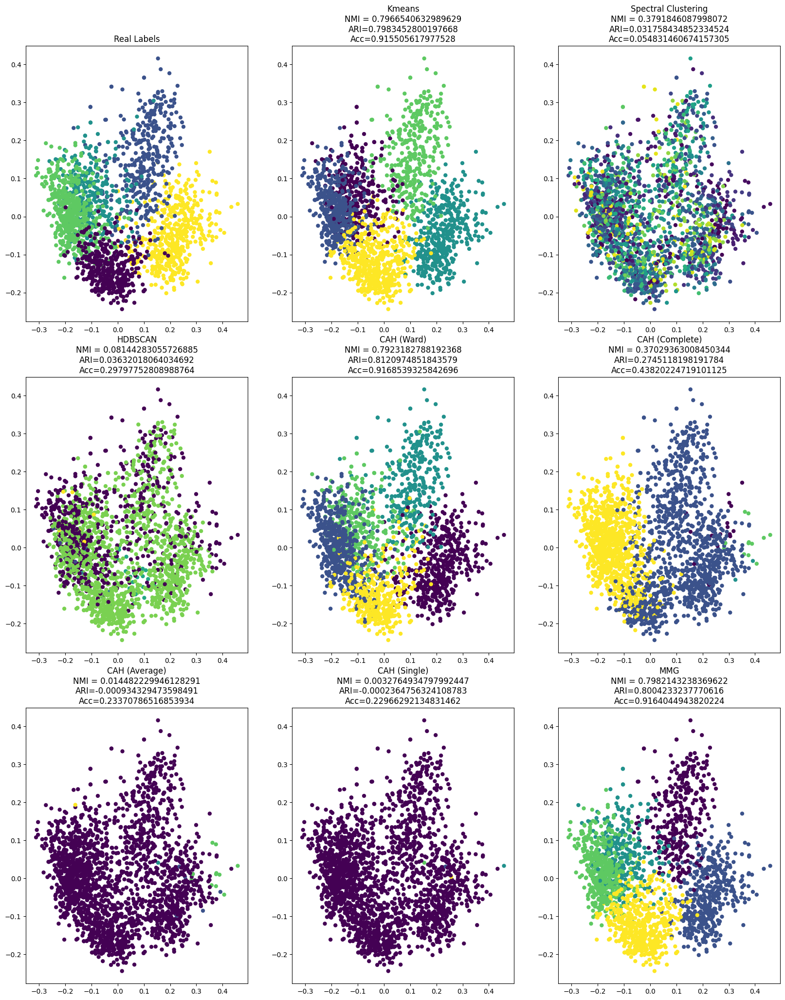

time: 2.69 s (started: 2023-05-16 08:42:13 +00:00)


In [ ]:
results_bbc_redim["original"] = eval_clustering_2D(X_reduced, map_labels(bbc_labels), [kmeans_labels, spectral_labels, hdbscan_labels, cah_labels_ward, cah_labels_complete, cah_labels_average, cah_labels_single, gaussian], ["Kmeans", "Spectral Clustering", "HDBSCAN", "CAH (Ward)", "CAH (Complete)","CAH (Average)", "CAH (Single)", "MMG"])

Les résultats obtenus en appliquant les algorithmes de clustering sur la représentation word2vec du dataset BBC montrent une répartition en deux classes distinctes : les modèles performants et les modèles moins performants. Les modèles Kmeans, MMG et CAH(ward) ont donné des résultats satisfaisants et encourageants, avec une précision supérieure à 91%, un indice de similarité NMI supérieur à 8% et un indice de rand ajusté supérieur à 79%. Le modèle CAH(ward) se démarque particulièrement. En revanche, les modèles moins performants sont HDBSCAN, CAH(average, single et complete), ainsi que le clustering spectral, avec une précision de seulement 43% et un indice de rand ajusté proche de zéro. Ces résultats indiquent que les classes sont non séparables et difficiles à distinguer dans ces cas.
Il apparaît que les classes sont relativement difficiles à séparer. 

Étant donné les temps d'exécution élevés, le clustering spectral ne sera pas exécuté avec tSNE.

## Espace réduit (Approche tandem)

### PCA avec 2 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


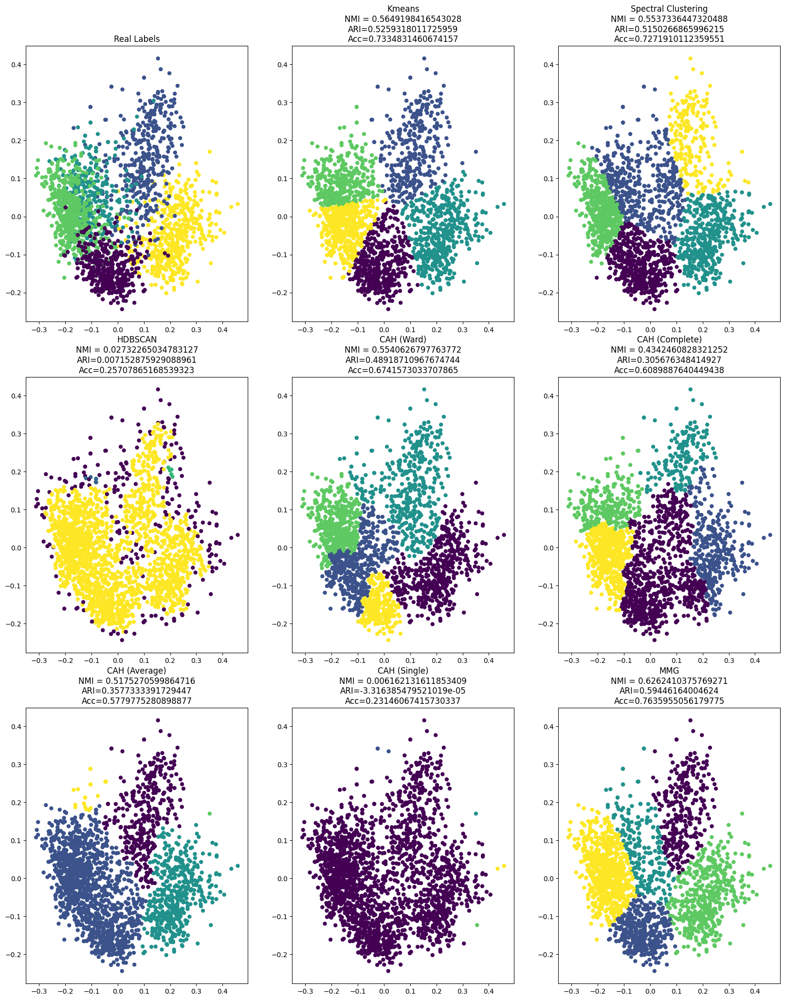

time: 5.6 s (started: 2023-05-16 08:42:16 +00:00)


In [ ]:
X_reduced = PCA(n_components=2, random_state=42).fit_transform(bbc_word2vec)
results_bbc_redim['pca2'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels), spectral=True)

### PCA avec 20 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


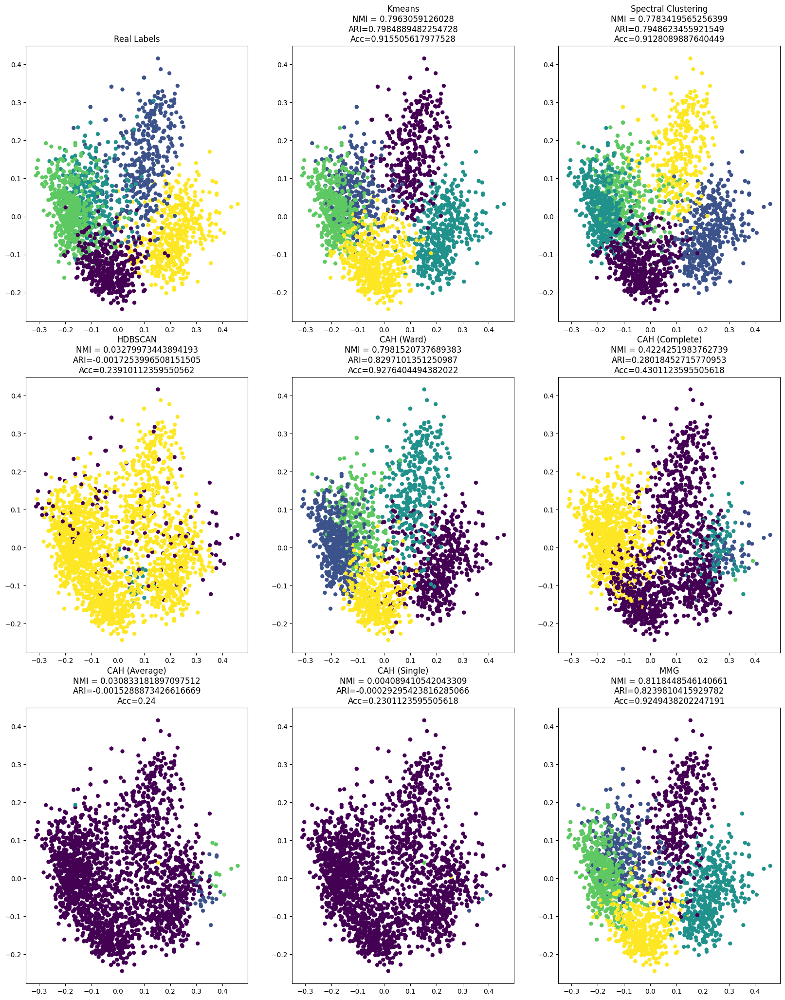

time: 4.75 s (started: 2023-05-16 08:42:21 +00:00)


In [ ]:
X_reduced = PCA(n_components=20, random_state=42).fit_transform(bbc_word2vec)
results_bbc_redim['pca20'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels), spectral=True)

Kmeans présente une dégradation de ses performances sur 2 composantes, mais récupère complètement son efficacité lorsqu'il est appliqué sur 20 composantes. Le clustering spectral, quant à lui, montre une nette amélioration de ses performances avec l'ACP et devient comparable à Kmeans. En revanche, HDBSCAN se distingue par de mauvaises performances sur l'ACP. En ce qui concerne le CAH, l'application de l'ACP à 2 composantes améliore les résultats pour les liens maximum et Ward. Cependant, lorsque l'ACP est réalisée avec 20 composantes, les performances se détériorent à nouveau pour les liens maximum et moyen, tandis que le lien Ward retrouve son efficacité. Pour MMG, les performances sont dégradées sur 2 composantes, mais deviennent comparables et même meilleures sur 20 composantes. Les modèles les plus performants sont MMG et CAH avec le lien Ward.

### TSNE avec 2 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


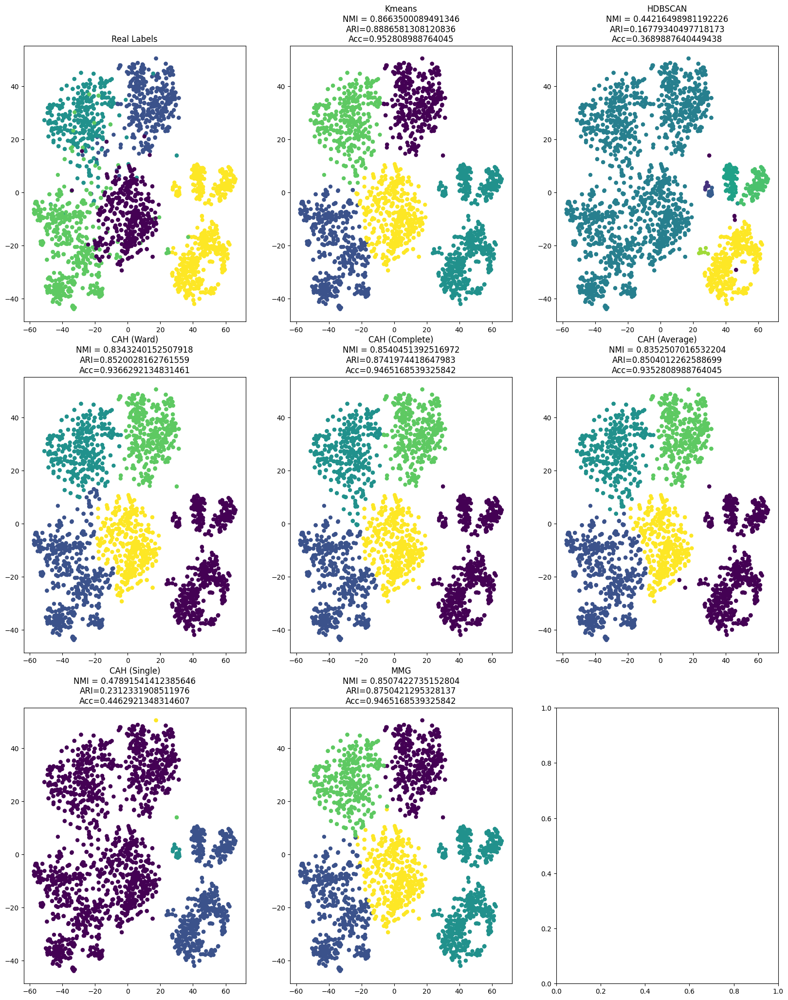

time: 22.9 s (started: 2023-05-16 08:42:26 +00:00)


In [ ]:
X_reduced_tsne = TSNE(n_components=2, random_state=42).fit_transform(bbc_word2vec)
results_bbc_redim['tsne'] = run_clustering(X_reduced_tsne, k_bbc, map_labels(bbc_labels))

L'utilisation de tSNE améliore les performances de Kmeans, atteignant une accuracy de 94% avec une NMI de 84%. HDBSCAN bénéficie également de l'application de tSNE, bien que les résultats ne soient pas encore suffisamment satisfaisants. En revanche, tSNE améliore considérablement les résultats de CAH avec toutes les méthodes de critères, le linkage moyen obtenant les meilleurs scores avec une NMI de 0,84, un ARI de 0,86 et une accuracy de 94% . MMG bénéficie également légèrement de tSNE avec une NMI de 85%, un ARI de 87 et une accuracy de 94%. Ainsi, dans l'espace tSNE, les meilleurs modèles sont Kmeans, CAH(Ward) et MMG, tous ayant une accuracy de 94%.

### UMAP avec 2 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


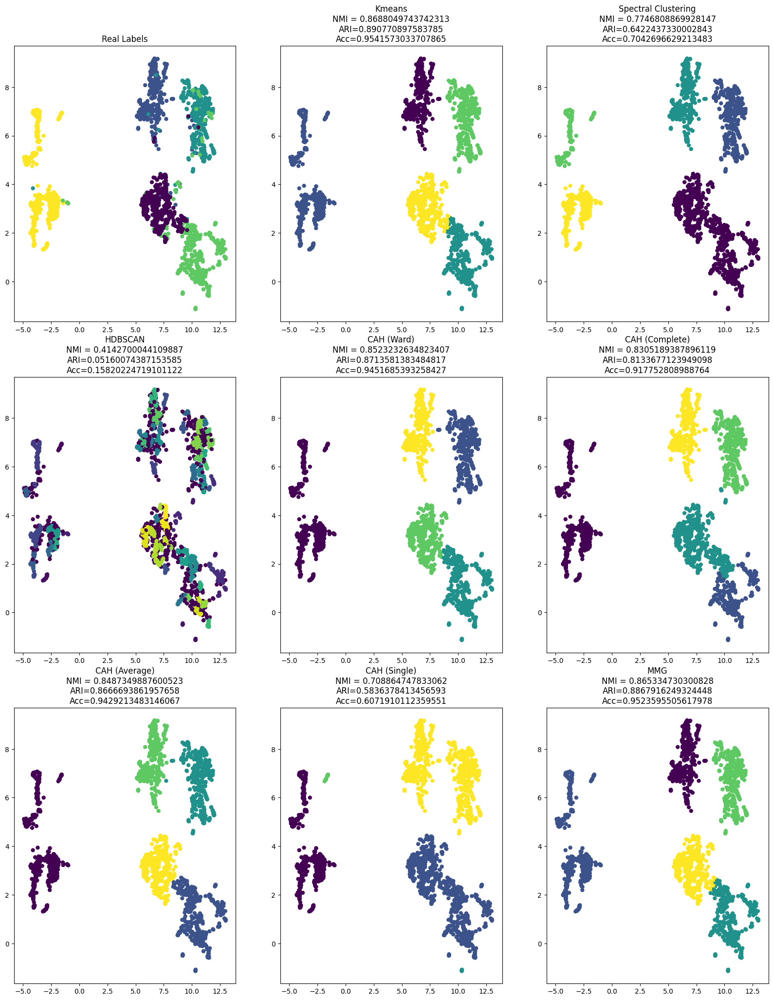

time: 23.9 s (started: 2023-05-16 08:42:49 +00:00)


In [ ]:
X_reduced = UMAP(n_components=2, random_state=42).fit_transform(bbc_word2vec)
results_bbc_redim['umap'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels), spectral=True)

### UMAP avec 20 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


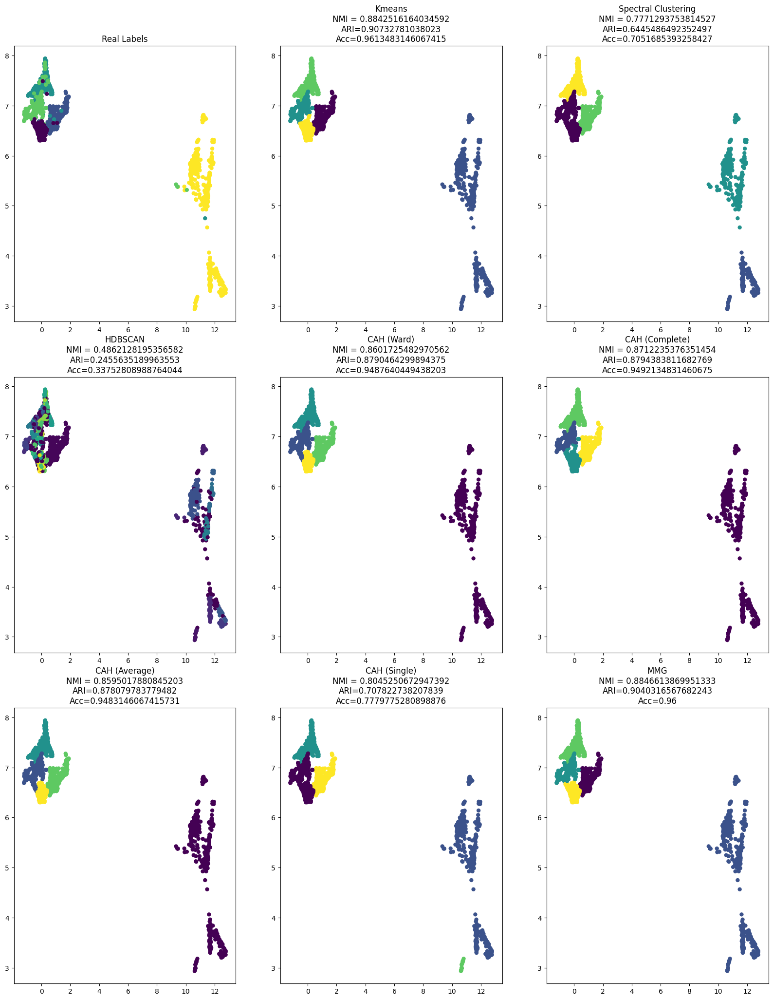

time: 18.7 s (started: 2023-05-16 08:43:13 +00:00)


In [ ]:
X_reduced = UMAP(n_components=20, random_state=42).fit_transform(bbc_word2vec)
results_bbc_redim['umap0'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels), spectral=True)

L'utilisation d'UMAP améliore considérablement les performances de Kmeans, atteignant une précision de 95%  avec une NMI de 86% . Spectral Clustering bénéficie également de l'application d'UMAP avec une accuracy de 70%, mais reste éloigné des meilleurs modèles. UMAP améliore également les résultats de HDBSCAN, bien que les résultats ne soient pas encore suffisamment satisfaisants. En revanche, UMAP booste les performances de CAH avec toutes les méthodes de couplage(critères), le critère ward obtenant le meilleur score avec 94,6% d'accuracy. MMG bénéficie également d'UMAP avec une NMI de 88% et un ARI de 90%, pour une accuracy de 96%. Ainsi, dans l'espace UMAP, les deux  meilleurs modèles sont  Kmeans et MMG avec une accuracy supérieure à 96%.

### Autoencodeur avec 2 composantes

100%|██████████| 50/50 [00:13<00:00,  3.70it/s]
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


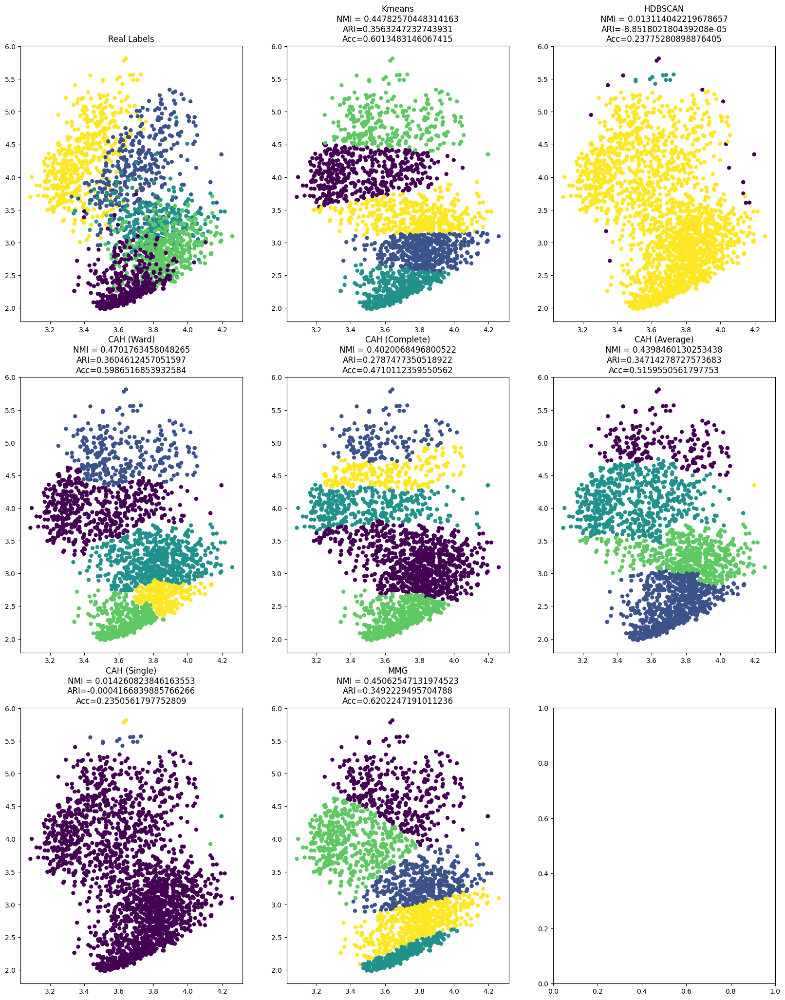

time: 16.2 s (started: 2023-05-16 08:43:32 +00:00)


In [ ]:
n_components=2
X_reduced = autoencoder(bbc_word2vec.astype("float32"), n_components, seed=42, learning_rate=1e-3)
results_bbc_redim['autoencoder'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels))

Les performances des différents modèles de clustering sont affectées négativement dans l'espace généré par l'autoencodeur, ce qui indique une séparabilité moindre par rapport à l'espace d'origine. Cela explique les résultats médiocres obtenus par tous les modèles comparativement aux espaces obtenus avec TSNE et UMAP ainsi que l'espace d'origine.

## Interprétations des résultats (word2vec)

In [ ]:
from copy import deepcopy
results_temp = deepcopy(results_bbc_redim)
for method in results_temp:
    for result in results_temp[method]:
        nmi, ari, acc = results_temp[method][result]
        results_temp[method][result] = {
            'nmi': nmi,
            "ari": ari,
            'acc': acc
        }

time: 2.78 ms (started: 2023-05-16 08:43:48 +00:00)


In [ ]:
results_word2vec_bbc = pd.DataFrame.from_dict({(i,j): results_temp[i][j] 
                           for i in results_temp.keys() 
                           for j in results_temp[i].keys()},
                       orient='index')

time: 12.4 ms (started: 2023-05-16 08:43:48 +00:00)


In [ ]:
results_word2vec_bbc

nmi       ari       acc
original    Kmeans               0.796654  0.798345  0.915506
            Spectral Clustering  0.379185  0.031758  0.054831
            HDBSCAN              0.081443  0.036320  0.297978
            CAH (Ward)           0.792318  0.812097  0.916854
            CAH (Complete)       0.370294  0.274512  0.438202
            CAH (Average)        0.014482 -0.000934  0.233708
            CAH (Single)         0.003276 -0.000236  0.229663
            MMG                  0.798214  0.800423  0.916404
pca2        Kmeans               0.564920  0.525932  0.733483
            Spectral Clustering  0.553734  0.515027  0.727191
            HDBSCAN              0.027323  0.007153  0.257079
            CAH (Ward)           0.554063  0.489187  0.674157
            CAH (Complete)       0.434246  0.305676  0.608989
            CAH (Average)        0.517527  0.357733  0.577978
            CAH (Single)         0.006162 -0.000033  0.231461
            MMG                  0.626241  0.594462  0.763596
pca20       Kmeans               0.796306  0.798489  0.915506
            Spectral Clustering  0.778342  0.794862  0.912809
            HDBSCAN              0.032800 -0.001725  0.239101
            CAH (Ward)           0.798152  0.829710  0.927640
            CAH (Complete)       0.422425  0.280185  0.430112
            CAH (Average)        0.030833 -0.001529  0.240000
            CAH (Single)         0.004089 -0.000293  0.230112
            MMG                  0.811845  0.823981  0.924944
tsne        Kmeans               0.866350  0.888658  0.952809
            HDBSCAN              0.442165  0.167793  0.368989
            CAH (Ward)           0.834324  0.852003  0.936629
            CAH (Complete)       0.854045  0.874197  0.946517
            CAH (Average)        0.835251  0.850401  0.935281
            CAH (Single)         0.478915  0.231233  0.446292
            MMG                  0.850742  0.875042  0.946517
umap        Kmeans               0.868805  0.890771  0.954157
            Spectral Clustering  0.774681  0.642244  0.704270
            HDBSCAN              0.414270  0.051601  0.158202
            CAH (Ward)           0.852323  0.871358  0.945169
            CAH (Complete)       0.830519  0.813368  0.917753
            CAH (Average)        0.848735  0.866669  0.942921
            CAH (Single)         0.708865  0.583638  0.607191
            MMG                  0.865335  0.886792  0.952360
umap0       Kmeans               0.884252  0.907328  0.961348
            Spectral Clustering  0.777129  0.644549  0.705169
            HDBSCAN              0.486213  0.245564  0.337528
            CAH (Ward)           0.860173  0.879046  0.948764
            CAH (Complete)       0.871224  0.879438  0.949213
            CAH (Average)        0.859502  0.878080  0.948315
            CAH (Single)         0.804525  0.707823  0.777978
            MMG                  0.884661  0.904032  0.960000
autoencoder Kmeans               0.447826  0.356325  0.601348
            HDBSCAN              0.013114 -0.000089  0.237753
            CAH (Ward)           0.470176  0.360461  0.598652
            CAH (Complete)       0.402007  0.278748  0.471011
            CAH (Average)        0.439846  0.347143  0.515955
            CAH (Single)         0.014261 -0.000417  0.235056
            MMG                  0.450625  0.349223  0.620225

time: 28.7 ms (started: 2023-05-16 08:43:48 +00:00)


In [ ]:
metric = "ari"
results_word2vec_bbc[results_word2vec_bbc[metric] == results_word2vec_bbc[metric].max()]

,,nmi,ari,acc
umap0,Kmeans,0.884252,0.907328,0.961348


time: 10.2 ms (started: 2023-05-16 08:43:48 +00:00)


In [ ]:
metric = "nmi"
results_word2vec_bbc[results_word2vec_bbc[metric] == results_word2vec_bbc[metric].max()]

,,nmi,ari,acc
umap0,MMG,0.884661,0.904032,0.96


time: 15.1 ms (started: 2023-05-16 08:43:48 +00:00)


In [ ]:
metric = "acc"
results_word2vec_bbc[results_word2vec_bbc[metric] == results_word2vec_bbc[metric].max()]

,,nmi,ari,acc
umap0,Kmeans,0.884252,0.907328,0.961348


time: 13.4 ms (started: 2023-05-16 08:43:48 +00:00)


Le modèle le plus performant est Kmeans lorsqu'il est appliqué sur UMAP avec 20 composantes.

In [ ]:
X_reduced_best = UMAP(n_components=20, random_state=42).fit_transform(bbc_word2vec)
best_labels = KMeans(n_clusters=k_bbc, random_state=42).fit(X_reduced_best).labels_

time: 14.4 s (started: 2023-05-16 08:47:31 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
def print_wordcloud(X, labels):
    temp_df = pd.DataFrame({
        "text": X,
        "labels": labels
    })
    for label in temp_df['labels'].unique():
        alltext = ' '.join(temp_df[temp_df['labels']== label]['text'])
        wordcloud = WordCloud().generate(alltext)
        # Display the generated image:
        print(f'Class: {label}')
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis("off")
        plt.show()
        print(f'\n')

time: 863 µs (started: 2023-05-16 08:47:45 +00:00)


Class: 0


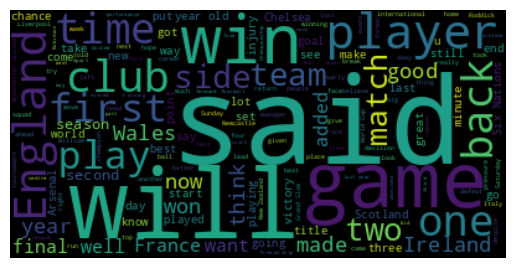



Class: 3


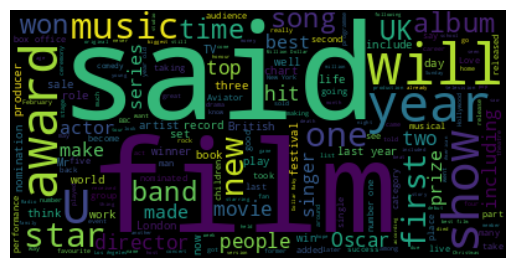



Class: 2


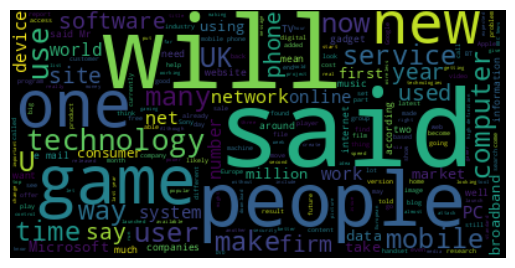



Class: 1


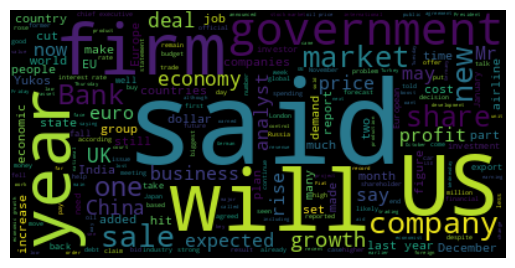



Class: 4


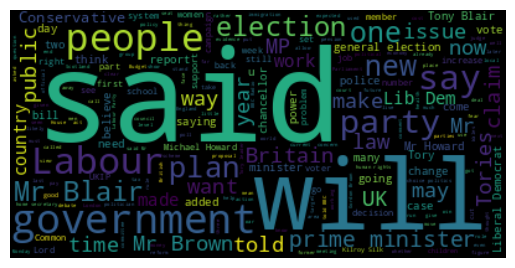



time: 6.58 s (started: 2023-05-16 08:47:45 +00:00)


In [ ]:
print_wordcloud(df['text'].values, best_labels)

Class: sport


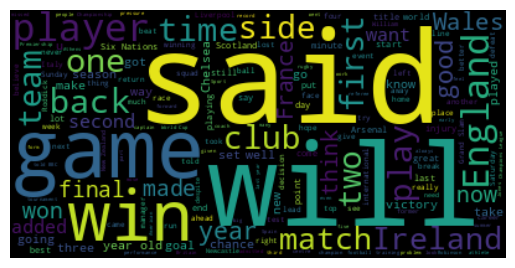



Class: entertainment


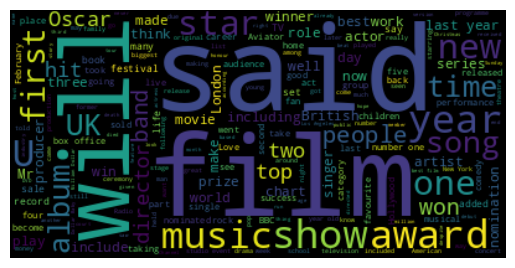



Class: tech


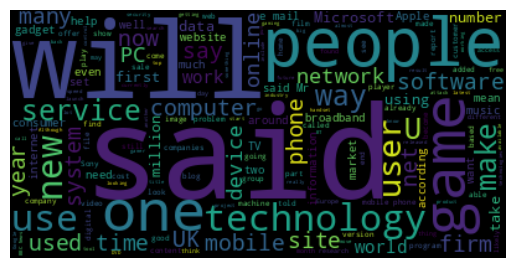



Class: business


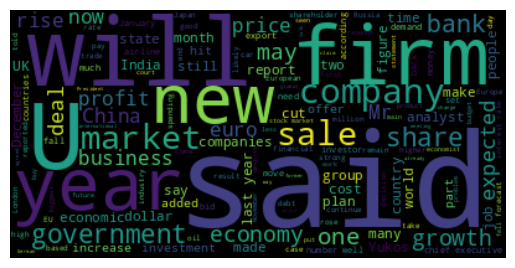



Class: politics


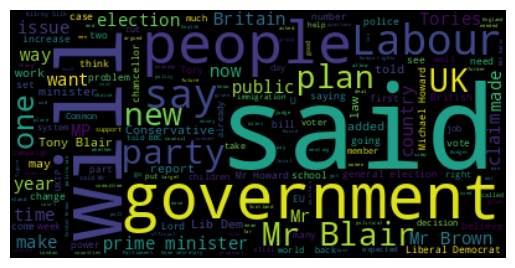



time: 8.51 s (started: 2023-05-16 08:47:52 +00:00)


In [ ]:
print_wordcloud(df['text'].values, df['label'].values)

En analysant les nuages de mots et en les comparant, les classes prédites peuvent être identifiées comme suit : la classe 0 est associée approximativement à "entertainment" en raison de la similarité des termes les plus fréquents dans les deux classes. La classe 1 correspond approximativement à "sport" car les termes les plus fréquents sont les mêmes. De même, la classe 2 peut être identifiée approximativement comme "business" en raison des termes les plus fréquents communs. La classe 3 peut être considérée approximativement comme "tech" en raison de la similitude des termes les plus fréquents. Enfin, la classe 4 peut être rapprochée de "politics" car les termes les plus fréquents sont similaires dans les deux classes.

# La représentation Glove

## Espace original

In [ ]:
X_reduced = PCA(n_components=2, random_state=42).fit_transform(bbc_glove)
kmeans_labels = KMeans(k_bbc, random_state=42).fit(bbc_glove).labels_
spectral_labels = SpectralClustering(k_bbc, n_components= bbc_glove.shape[1], assign_labels="discretize", random_state=42).fit(bbc_glove).labels_
hdbscan_labels = hdbscan.HDBSCAN(algorithm="best", alpha=1.0, leaf_size=40, cluster_selection_method="eom", metric="euclidean").fit(bbc_glove).labels_
cah_labels_ward = AgglomerativeClustering(n_clusters=k_bbc).fit_predict(bbc_glove)
cah_labels_complete = AgglomerativeClustering(n_clusters=k_bbc, linkage="complete").fit_predict(bbc_glove)
cah_labels_average = AgglomerativeClustering(n_clusters=k_bbc, linkage="average").fit_predict(bbc_glove)
cah_labels_single = AgglomerativeClustering(n_clusters=k_bbc, linkage="single").fit_predict(bbc_glove)
gaussian = GaussianMixture(n_components=k_bbc, random_state=42).fit_predict(bbc_glove)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


time: 24.6 s (started: 2023-05-16 08:49:17 +00:00)


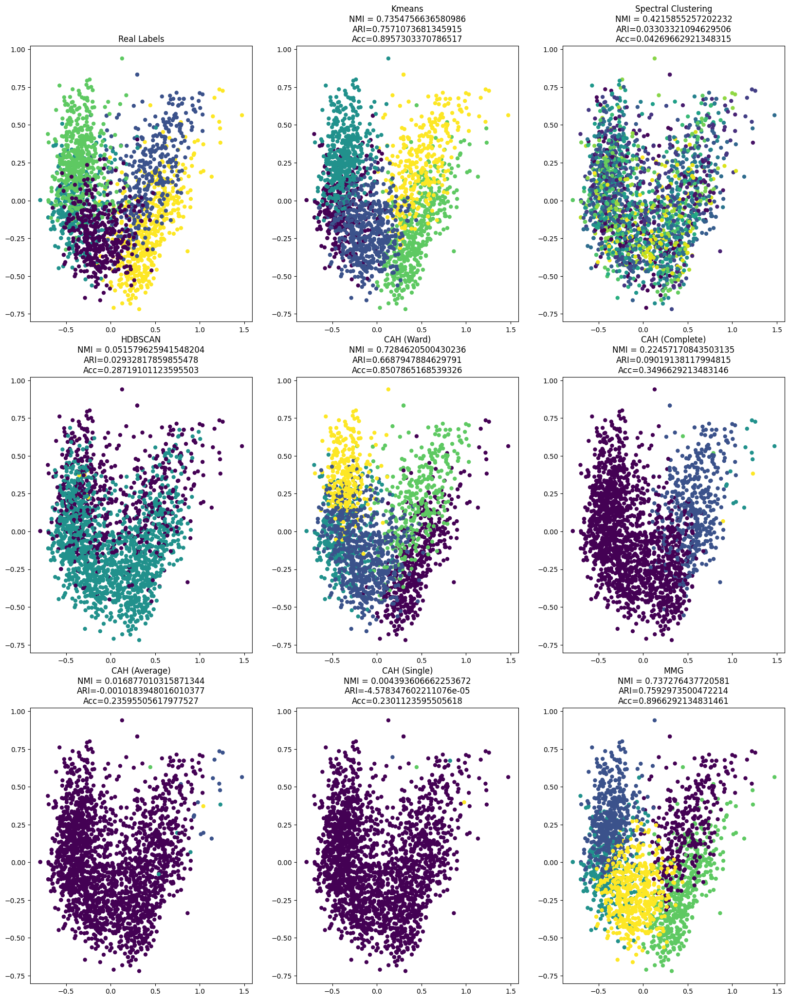

time: 2.17 s (started: 2023-05-16 08:49:41 +00:00)


In [ ]:
results_bbc_glove_redim["original"] = eval_clustering_2D(X_reduced, map_labels(bbc_labels), [kmeans_labels, spectral_labels, hdbscan_labels, cah_labels_ward, cah_labels_complete, cah_labels_average, cah_labels_single, gaussian], ["Kmeans", "Spectral Clustering", "HDBSCAN", "CAH (Ward)", "CAH (Complete)","CAH (Average)", "CAH (Single)", "MMG"])

 Les résultats obtenus indiquent que les différentes méthodes de classification utilisées ne parviennent pas à séparer efficacement les classes dans leur espace d'origine, avec la plupart des résultats se rapprochant de l'estimation aléatoire des étiquettes (ARI proche de 0). Toutefois, il est intéressant de noter que les modèles Kmeans, CAH(Ward) et MMG obtiennent de meilleurs résultats que les autres modèles, en parvenant à classer entre 85% et 89% des données. Le modèle MMG se distingue particulièrement, avec une accuracy de 89% et une NMI de 73% et un ari supérieur à 75% , ce qui en fait le meilleur modèle parmi ceux évalués.

## Espace réduit (approche tandem)

### PCA avec 2 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


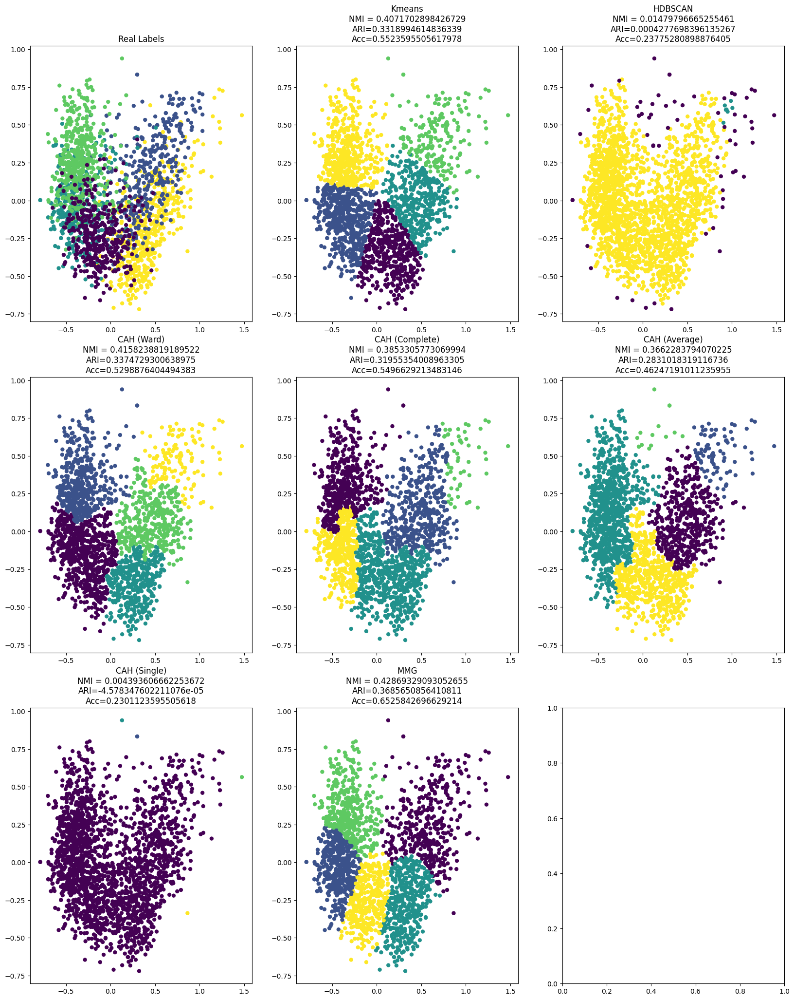

time: 3.92 s (started: 2023-05-16 08:49:43 +00:00)


In [ ]:
X_reduced = PCA(n_components=2, random_state=42).fit_transform(bbc_glove)
results_bbc_glove_redim['pca2'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels))

### PCA avec 20 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


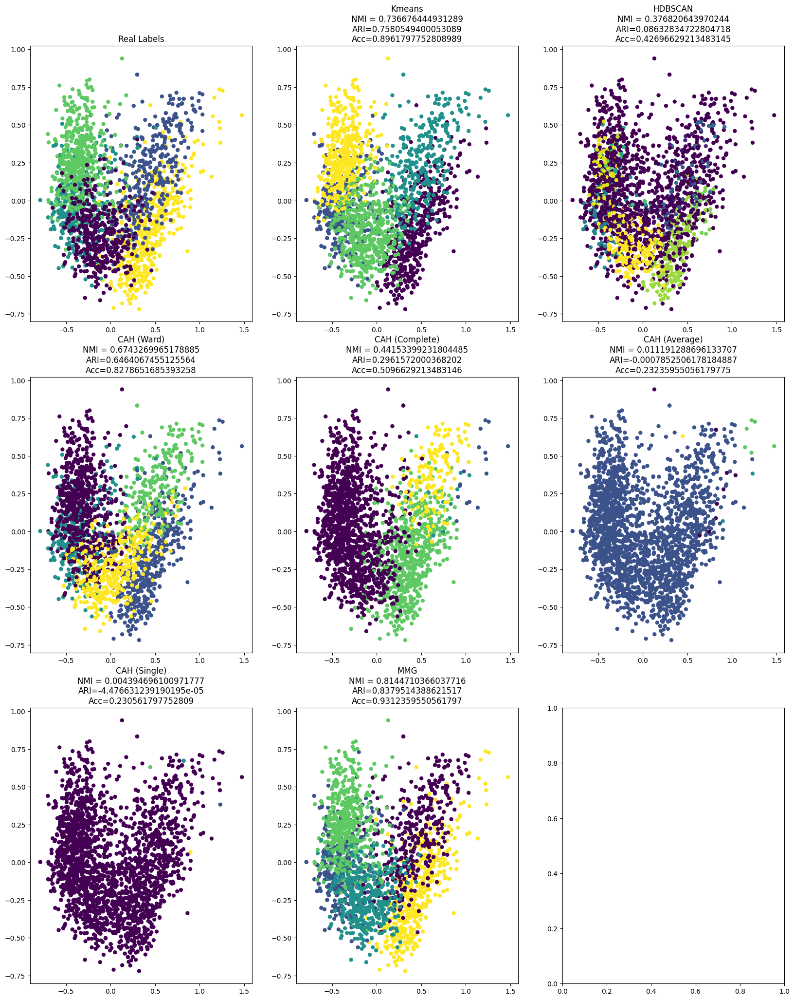

time: 4.35 s (started: 2023-05-16 08:49:47 +00:00)


In [ ]:
X_reduced = PCA(n_components=20, random_state=42).fit_transform(bbc_glove)
results_bbc_glove_redim['pca20'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels))

En observant les résultats, il est évident que l'utilisation d'une ACP à 2 ou 20 composantes a entraîné une dégradation des performances des modèles de clustering utilisés. Cela peut être attribué au fait que l'espace dans lequel nous projetons les données n'est pas adéquat pour bien séparer les différentes classifications. Il est intéressant de noter que passer de 2 à 20 composantes n'a pas amélioré les performances , à l'exception de Kmeans qui a retrouvé ses performances initiales et de MMG qui s'est amélioré avec une accuracy de 93%. Parmi les modèles évalués, MMG se distingue comme le meilleur, avec une NMI de 81%.

### TSNE avec 2 composantes

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


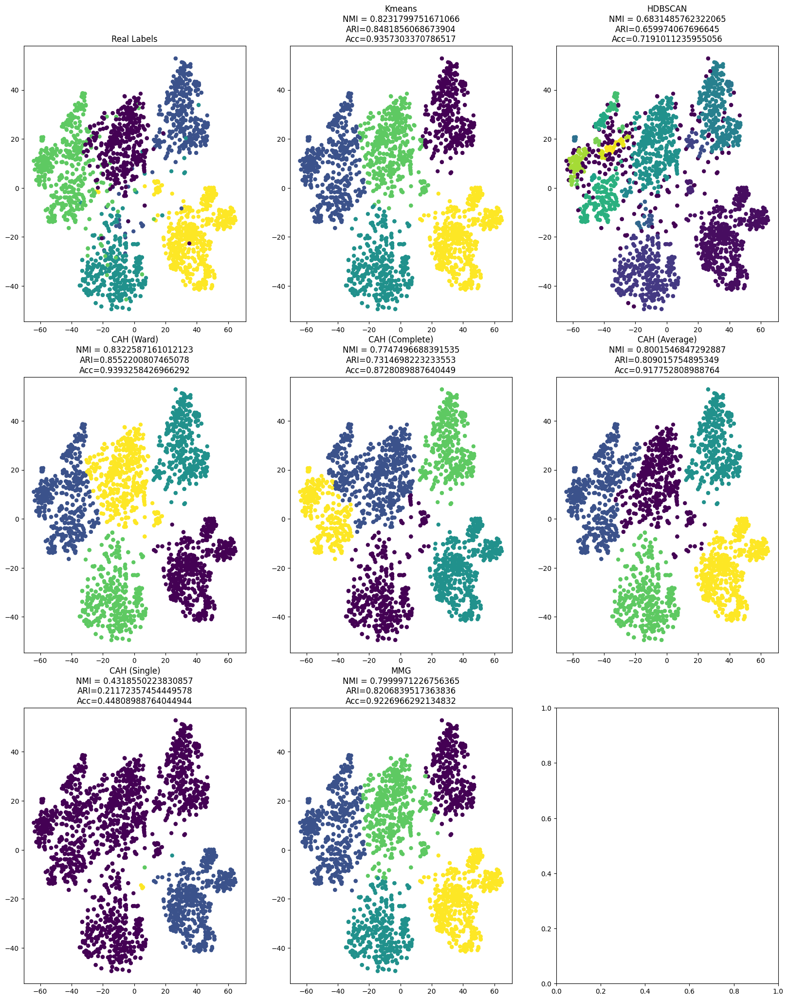

time: 25.9 s (started: 2023-05-16 08:49:52 +00:00)


In [ ]:
X_reduced_tsne = TSNE(n_components=2, random_state=42).fit_transform(bbc_glove)
results_bbc_glove_redim['tsne'] = run_clustering(X_reduced_tsne, k_bbc, map_labels(bbc_labels))

La méthode tSNE améliore les performances de Kmeans, avec une précision de 93%  et une NMI de 0.82. HDBSCAN bénéficie également d'une amélioration grâce à tSNE, bien que cela ne soit pas encore suffisant pour atteindre des performances élevées. Quant à CAH, toutes les méthodes de couplage bénéficient d'un boost grâce à tSNE, avec le couplage Ward en tête avec une NMI de 82%, un ARI de 85% et une accuracy de 93%. MMG bénéficie également légèrement de tSNE, avec une NMI de 79%, un ARI de 81% et une accuracy de 92%. En conclusion, dans le contexte de tSNE, les meilleurs modèles sont Kmeans et CAH(Ward) avec une accuracy de 93%.

### UMAP avec 2 composantes

In [ ]:
X_reduced = UMAP(n_components=2, random_state=42).fit_transform(bbc_glove)

time: 10 s (started: 2023-05-16 08:50:18 +00:00)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


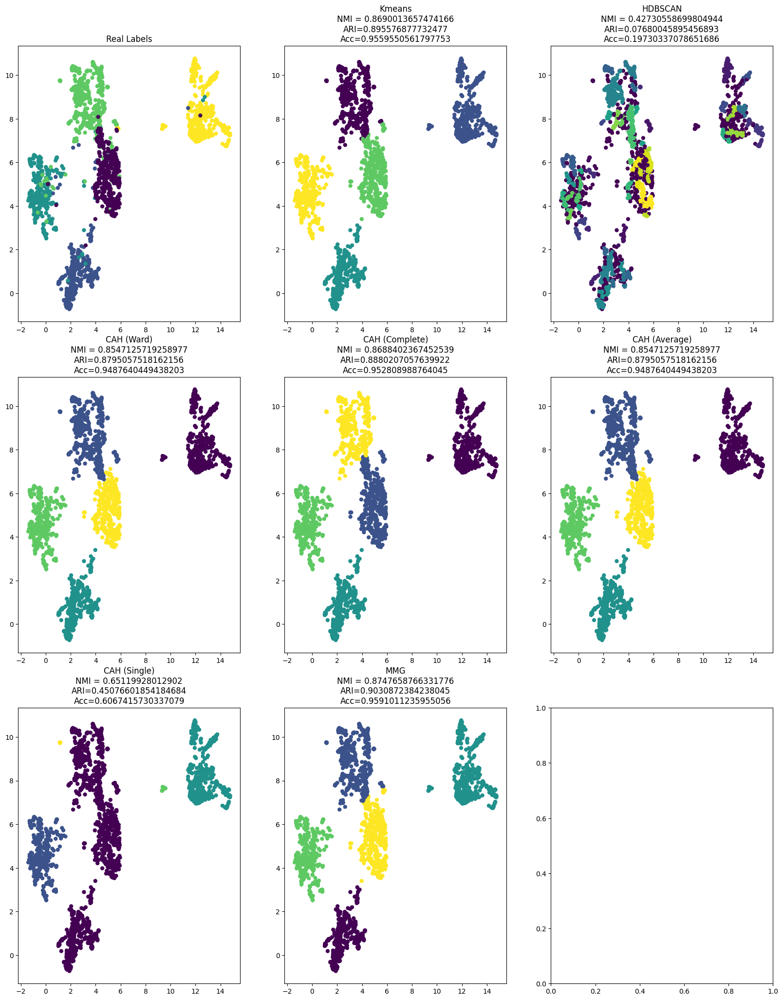

time: 2.87 s (started: 2023-05-16 08:50:28 +00:00)


In [ ]:
results_bbc_glove_redim['umap'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels))

### UMAP avec 20 composantes

In [ ]:
X_reduced = UMAP(n_components=20, random_state=42).fit_transform(bbc_glove)

time: 14.4 s (started: 2023-05-16 08:50:31 +00:00)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


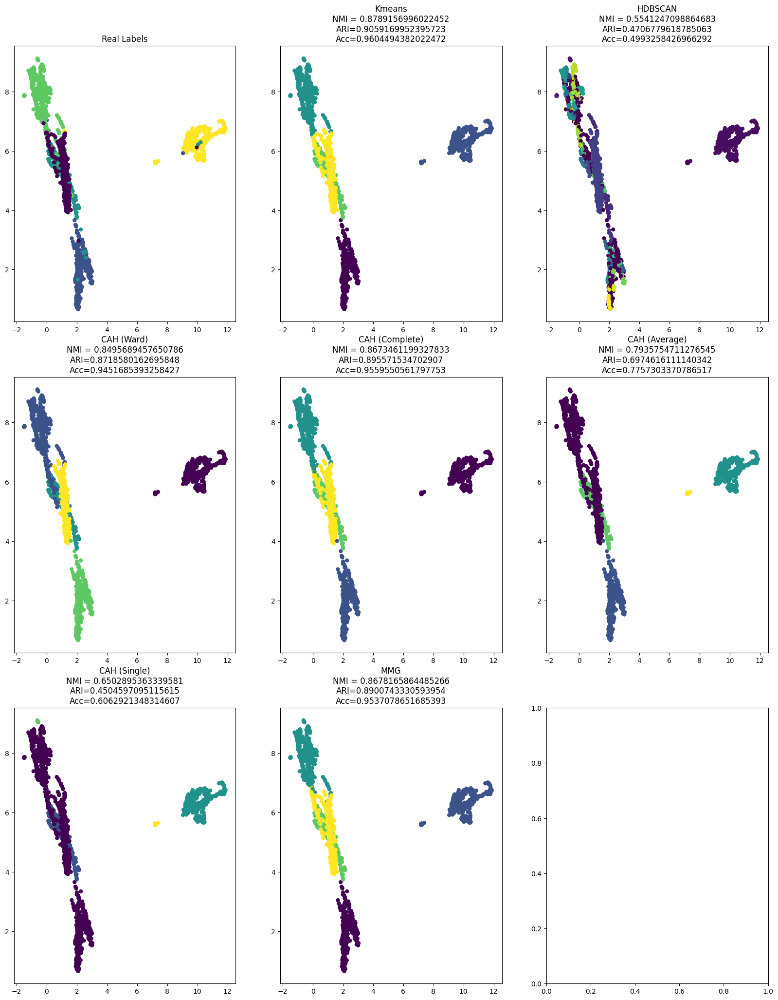

time: 2.83 s (started: 2023-05-16 08:50:45 +00:00)


In [ ]:
results_bbc_glove_redim['umap20'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels))

UMAP améliore considérablement les performances de Kmeans, avec une précision de 95.8%  et une NMI de 87%. Spectral Clustering bénéficie également d'une amélioration grâce à UMAP, bien que ses performances restent inférieures à celles des meilleurs modèles, avec une précision de 77%. UMAP apporte également des améliorations à HDBSCAN, bien que cela ne soit pas encore suffisant pour atteindre des performances élevées. CAH profite également de l'utilisation d'UMAP, avec toutes les méthodes de couplage bénéficiant d'un boost, notamment le couplage Ward qui atteint une précision de 95.6%. MMG bénéficie légèrement de l'utilisation d'UMAP, avec une précision de 95.4%. En conclusion, dans le contexte d'UMAP, le meilleur modèle est Kmeans avec une précision de 95.8%.

### Autoencodeur avec 2 composantes

In [ ]:
n_components=2
X_reduced = autoencoder(bbc_glove.astype("float32"), n_components, seed=42, learning_rate=1e-3)

100%|██████████| 50/50 [00:13<00:00,  3.72it/s]


time: 13.5 s (started: 2023-05-16 08:50:48 +00:00)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


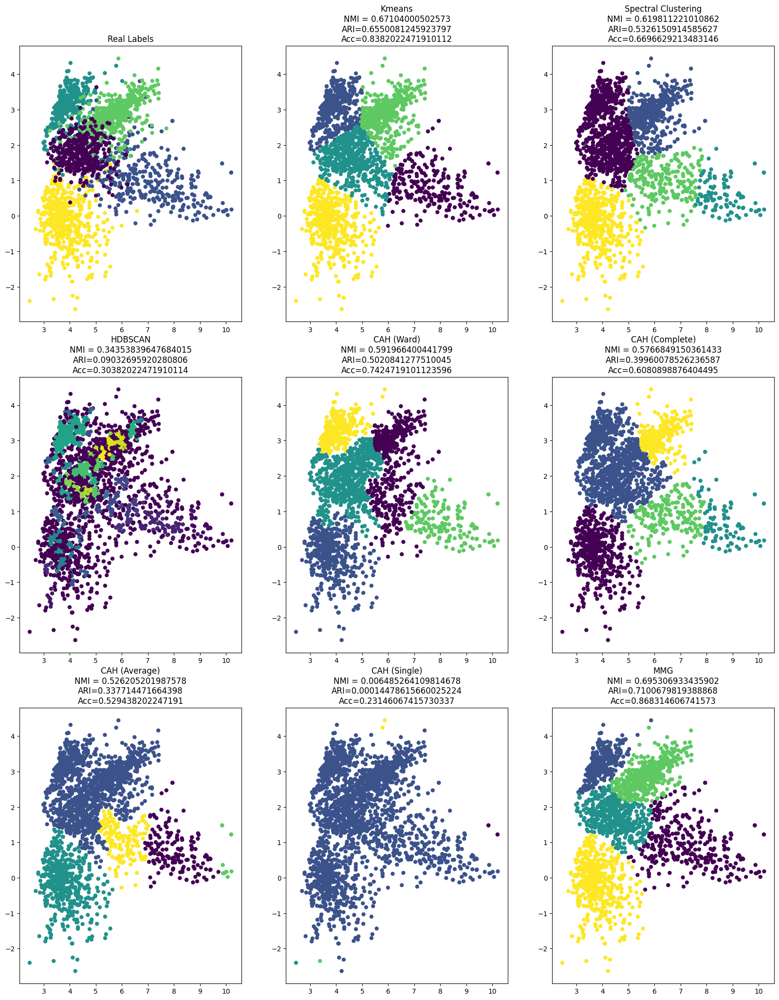

time: 4.24 s (started: 2023-05-16 08:51:01 +00:00)


In [ ]:
results_bbc_glove_redim['autoencoder'] = run_clustering(X_reduced, k_bbc, map_labels(bbc_labels), spectral=True)

Les résultats de l'application des différentes méthodes de clustering sur l'espace issu de l'autoencodeur montrent que Kmeans, CAH (ward) et MMG ont des performances réduites, tandis que Spectral Clustering, Kmeans spectral et les autres modèles obtiennent de meilleures performances mais ne rivalisent pas avec les meilleurs modèles. Parmi eux, MMG se distingue en obtenant la meilleure accuracy de 87%.

###Interprétations des résultats(représentation glove)

In [ ]:
from copy import deepcopy
results_temp = deepcopy(results_bbc_glove_redim)
for method in results_temp:
    for result in results_temp[method]:
        nmi, ari, acc = results_temp[method][result]
        results_temp[method][result] = {
            'nmi': nmi,
            "ari": ari,
            'acc': acc
        }

time: 1.83 ms (started: 2023-05-16 08:51:06 +00:00)


In [ ]:
results_glove_bbc = pd.DataFrame.from_dict({(i,j): results_temp[i][j] 
                           for i in results_temp.keys() 
                           for j in results_temp[i].keys()},
                       orient='index')

time: 3.43 ms (started: 2023-05-16 08:51:06 +00:00)


In [ ]:
results_glove_bbc

nmi       ari       acc
original    Kmeans               0.735476  0.757107  0.895730
            Spectral Clustering  0.421586  0.033033  0.042697
            HDBSCAN              0.051580  0.029328  0.287191
            CAH (Ward)           0.728462  0.668795  0.850787
            CAH (Complete)       0.224572  0.090191  0.349663
            CAH (Average)        0.016877 -0.001018  0.235955
            CAH (Single)         0.004394 -0.000046  0.230112
            MMG                  0.737276  0.759297  0.896629
pca2        Kmeans               0.407170  0.331899  0.552360
            HDBSCAN              0.014798  0.000428  0.237753
            CAH (Ward)           0.415824  0.337473  0.529888
            CAH (Complete)       0.385331  0.319554  0.549663
            CAH (Average)        0.366228  0.283102  0.462472
            CAH (Single)         0.004394 -0.000046  0.230112
            MMG                  0.428693  0.368565  0.652584
pca20       Kmeans               0.736676  0.758055  0.896180
            HDBSCAN              0.376821  0.086328  0.426966
            CAH (Ward)           0.674327  0.646407  0.827865
            CAH (Complete)       0.441534  0.296157  0.509663
            CAH (Average)        0.011191 -0.000785  0.232360
            CAH (Single)         0.004395 -0.000045  0.230562
            MMG                  0.814471  0.837951  0.931236
tsne        Kmeans               0.823180  0.848186  0.935730
            HDBSCAN              0.683149  0.659974  0.719101
            CAH (Ward)           0.832259  0.855220  0.939326
            CAH (Complete)       0.774750  0.731470  0.872809
            CAH (Average)        0.800155  0.809016  0.917753
            CAH (Single)         0.431855  0.211724  0.448090
            MMG                  0.799997  0.820684  0.922697
umap        Kmeans               0.869001  0.895577  0.955955
            HDBSCAN              0.427306  0.076800  0.197303
            CAH (Ward)           0.854713  0.879506  0.948764
            CAH (Complete)       0.868840  0.888021  0.952809
            CAH (Average)        0.854713  0.879506  0.948764
            CAH (Single)         0.651199  0.450766  0.606742
            MMG                  0.874766  0.903087  0.959101
umap20      Kmeans               0.878916  0.905917  0.960449
            HDBSCAN              0.554125  0.470678  0.499326
            CAH (Ward)           0.849569  0.871858  0.945169
            CAH (Complete)       0.867346  0.895572  0.955955
            CAH (Average)        0.793575  0.697462  0.775730
            CAH (Single)         0.650290  0.450460  0.606292
            MMG                  0.867817  0.890074  0.953708
autoencoder Kmeans               0.671040  0.655008  0.838202
            Spectral Clustering  0.619811  0.532615  0.669663
            HDBSCAN              0.343538  0.090327  0.303820
            CAH (Ward)           0.591966  0.502084  0.742472
            CAH (Complete)       0.576685  0.399601  0.608090
            CAH (Average)        0.526205  0.337714  0.529438
            CAH (Single)         0.006485  0.000145  0.231461
            MMG                  0.695307  0.710068  0.868315

time: 26.4 ms (started: 2023-05-16 08:51:06 +00:00)


In [ ]:
metric = "ari"
results_glove_bbc[results_glove_bbc[metric] == results_glove_bbc[metric].max()]

,,nmi,ari,acc
umap20,Kmeans,0.878916,0.905917,0.960449


time: 13.6 ms (started: 2023-05-16 08:51:06 +00:00)


In [ ]:
metric = "nmi"
results_glove_bbc[results_glove_bbc[metric] == results_glove_bbc[metric].max()]

,,nmi,ari,acc
umap20,Kmeans,0.878916,0.905917,0.960449


time: 13.8 ms (started: 2023-05-16 08:51:06 +00:00)


In [ ]:
metric = "acc"
results_glove_bbc[results_glove_bbc[metric] == results_glove_bbc[metric].max()]

,,nmi,ari,acc
umap20,Kmeans,0.878916,0.905917,0.960449


time: 12.5 ms (started: 2023-05-16 08:51:06 +00:00)


Le modèle le plus performant est Kmeans avec UMAP utilisant 20 composantes.

In [ ]:
X_reduced_best = UMAP(n_components=20, random_state=42).fit_transform(bbc_glove)
best_labels = KMeans(n_clusters=k_bbc, random_state=42).fit(X_reduced_best).labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


time: 15.3 s (started: 2023-05-16 08:51:06 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
def print_wordcloud(X, labels):
    temp_df = pd.DataFrame({
        "text": X,
        "labels": labels
    })
    for label in temp_df['labels'].unique():
        alltext = ' '.join(temp_df[temp_df['labels']== label]['text'])
        wordcloud = WordCloud().generate(alltext)
        # Display the generated image:
        print(f'Class: {label}')
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis("off")
        plt.show()
        print(f'\n')

time: 1.12 ms (started: 2023-05-16 08:51:21 +00:00)


Class: 1


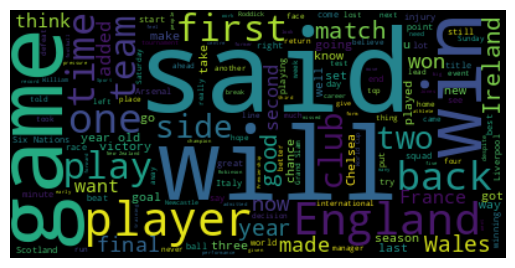



Class: 4


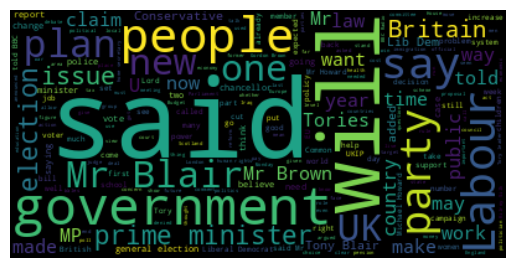



Class: 2


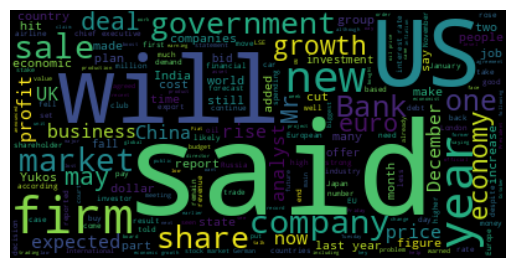



Class: 0


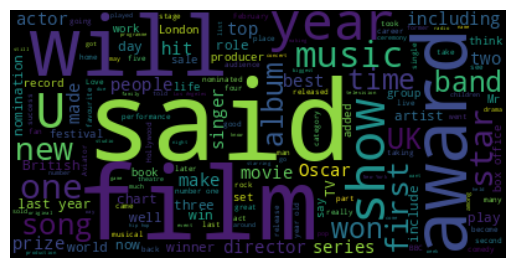



Class: 3


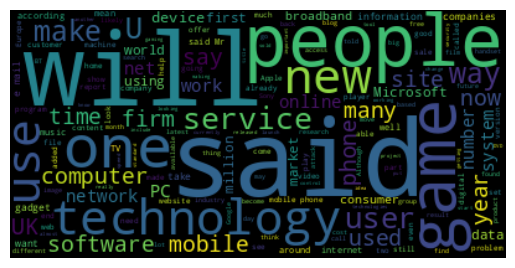



time: 7.78 s (started: 2023-05-16 08:51:21 +00:00)


In [ ]:
print_wordcloud(df_bbc['text'].values, best_labels)

Class: sport


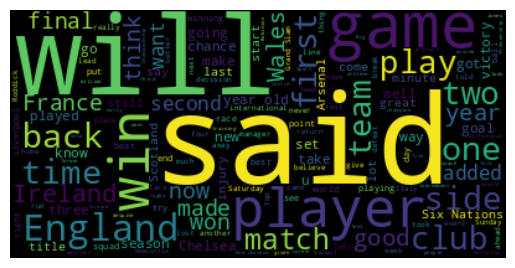



Class: entertainment


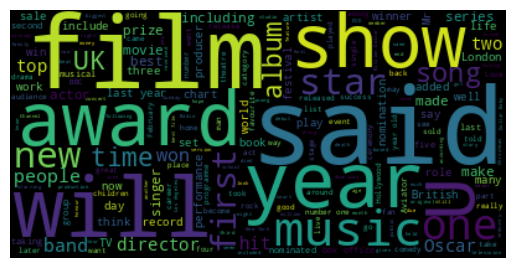



Class: tech


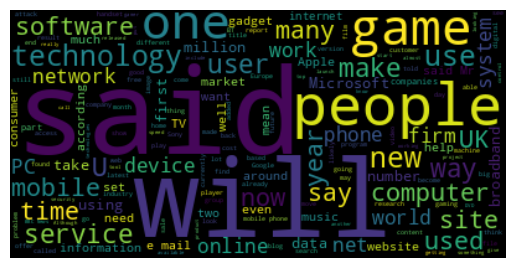



Class: business


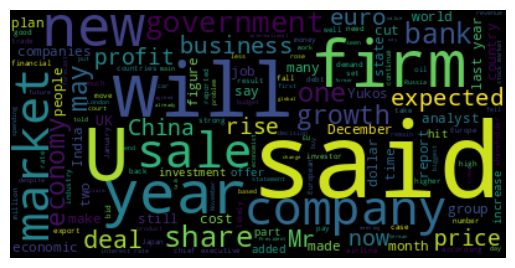



Class: politics


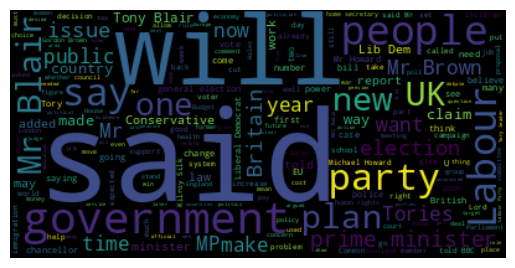



time: 7.35 s (started: 2023-05-16 08:51:29 +00:00)


In [ ]:
print_wordcloud(df_bbc['text'].values, df_bbc['label'].values)

En analysant les nuages de mots et en les comparant, nous observons que les classes prédites correspondent approximativement aux catégories suivantes : la classe 0 est associée à "business", la classe 1 à "entertainment", la classe 2 à "sports", la classe 3 à "tech" et la classe 4 à "politics". Cette correspondance est basée sur la similarité des termes les plus fréquents présents dans les deux classes respectives.